# 100 Sports Image Classification using ResNet-50

$by: Jeremiah\space Chinyelugo$

In this notebook, we perform transfer learning, by tuning a pre-trained ResNet-50 model to accurately classify images of 100 sports.

### So why the fuss about convolutional neural networks (CNNs)?
Well, CNNs are widely used in various real-life applications for tasks involving image and video data. This includes:

- Image classification: recognizing and classifying objects within images, this can range from identifying digits, to detecting facial expressions. distinguishing between various objects in autonomous driving, such as pedestrians, traffic signs, and vehicles.

- Object detection: classifying and locating multiple objects within an image. A common use case is distinguishing between various objects in autonomous driving, such as pedestrians, traffic signs, and vehicles.

- Image Segmentation: involves dividing an image into meaningful and distinct regions, where each pixel is assigned a specific label or category. This can be used for detecting specific cancerous cells in medical imaging, or satellite and aerial imagery analysis.

- Video analysis: action recognition and video surveillance to automatically recognize and classify different activities within a video stream, allowing for applications like video-based human-computer interaction, surveillance systems, and video summarization.


### Data

The data used for this project was gotten from [kaggle](https://www.kaggle.com/datasets/gpiosenka/sports-classification). It consists of approximately 13k training images of 100 different sports, with 500 validation and test images.


## Contents
1. Downloading the dataset from Kaggle
2. Importing relevant packages
3. Loading the dataset from the directory
4. Visualizing the data
5. Transfer Learning using Pretrained ResNet-50 model
6. Training and evaluating our model

#### Downloading the dataset

In [1]:
import opendatasets as od

In [2]:
od.download("https://www.kaggle.com/datasets/gpiosenka/sports-classification?datasetId=1209061&sortBy=voteCount&select=train")

Skipping, found downloaded files in ".\sports-classification" (use force=True to force download)


#### Importing relevant packages

In [3]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import seaborn as sns
from functools import partial
import tensorflow_hub as hub
from sklearn.metrics import classification_report, confusion_matrix

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

#### Loading the dataset from current directory

The `keras.preprocessing.image_dataset_from_directory` function is extremely effiecient in retrieving image dataset from a directory, and performing some preprocessing on the dataset. 

We are going to load each dataset into a variable using a batch_size of `16` and integer labels.

In [4]:
train_data = tf.keras.preprocessing.image_dataset_from_directory(
    directory='.\\sports-classification\\train', labels='inferred',
    label_mode='int', class_names=None, batch_size=16, 
    image_size=(224,224), shuffle=True, seed=None, validation_split=None, subset=None,
    interpolation='bilinear', follow_links=False
)

val_data = tf.keras.preprocessing.image_dataset_from_directory(
    directory='.\\sports-classification\\valid', labels='inferred',
    label_mode='int', class_names=None, batch_size=16, 
    image_size=(224,224), shuffle=True, seed=None, validation_split=None, subset=None,
    interpolation='bilinear', follow_links=False
)

test_data = tf.keras.preprocessing.image_dataset_from_directory(
    directory='.\\sports-classification\\test', labels='inferred',
    label_mode='int', class_names=None, batch_size=16, 
    image_size=(224,224), shuffle=True, seed=None, validation_split=None, subset=None,
    interpolation='bilinear', follow_links=False
)

Found 13492 files belonging to 100 classes.
Found 500 files belonging to 100 classes.
Found 500 files belonging to 100 classes.


In [5]:
# retieving our image classes

class_names = train_data.class_names

#### Visualizing our data

Our dataset has looks as expected, with each image having the correct label

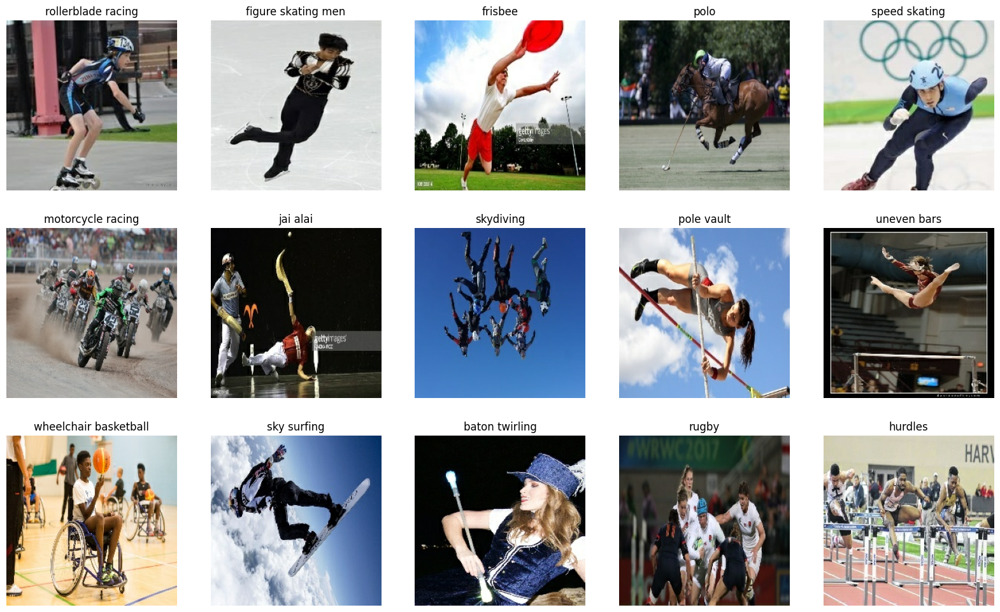

In [6]:
plt.figure(figsize=(20,12))
for x in train_data.take(1):
    for i in range(15):
        plt.subplot(3,5,i+1)
        image = x[0][i] / 255.
        plt.imshow(image)
        plt.title(class_names[x[1][i].numpy()])
        plt.axis('off')

In [7]:
# caching and prefetching our dataset fto increase efficiency during training

train_data = train_data.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
val_data = val_data.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_data = test_data.cache()

#### Transfer Learning using Pre-trained model

**What is transfer learning?**

Transfer learning is a machine learning technique that allows a pre-trained model, which has been trained on a large dataset, to be reused as a starting point for a different but related task or dataset. Instead of training a model from scratch, transfer learning leverages the knowledge and learned representations of the pre-trained model to accelerate and improve the training process for a new task.

In transfer learning, the pre-trained model, typically a deep neural network, has already learned to extract relevant features and patterns from the original dataset it was trained on, which is often a large-scale, general-purpose dataset such as ImageNet. These learned features capture generic image characteristics like edges, textures, shapes, and higher-level object representations.

To apply transfer learning, the pre-trained model is taken as a base network, and the final layers of the network, responsible for the specific task or output, are replaced or fine-tuned. The idea is to retain the pre-trained network's knowledge of low-level and intermediate features while adapting the higher-level layers to the new task or dataset.

This can help with :

1. Reduced Training Time: reduces the time and computational resources required to train a model from scratch. Since the base network has already learned a rich set of features, only the final layers need to be trained, resulting in faster convergence.

2. Improved Performance: Pre-trained models often exhibit strong generalization capabilities due to their exposure to a large and diverse dataset. By leveraging these learned representations, transfer learning can enhance the model's performance on the new task, especially when the new dataset is limited or lacks sufficient training samples.

3. Handling Data Scarcity: Transfer learning is particularly useful when the target task has limited labeled data. The pre-trained model's knowledge serves as a form of regularization, preventing overfitting and improving generalization on the new dataset.


**ResNet-50**

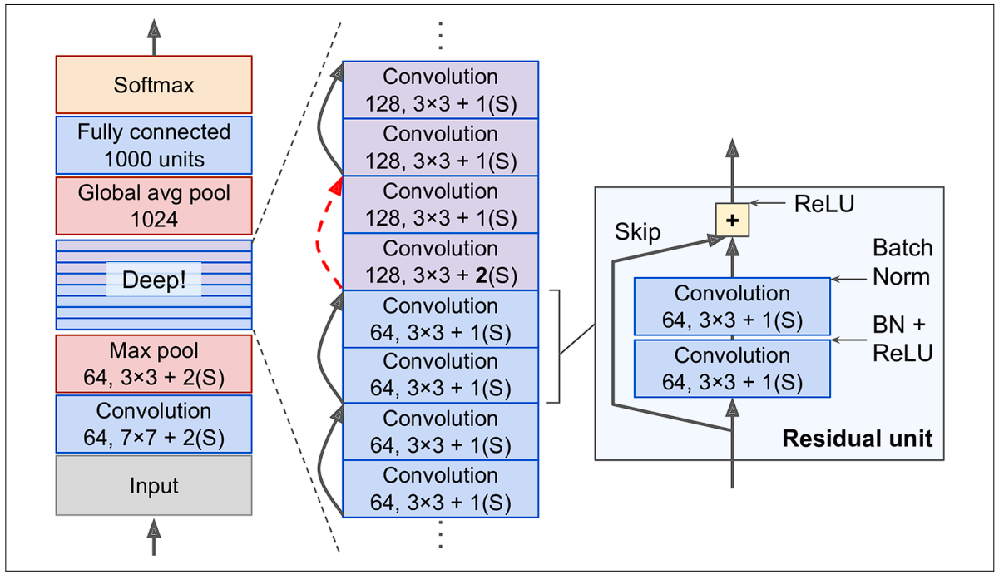

ResNet-50 is a CNN architecture used in computer vision tasks, including image classification, object detection, and image segmentation.

The "50" in ResNet-50 refers to the number of layers in the network. ResNet-50 consists of a deep stack of 50 convolutional layers, including residual blocks, which are the key innovation of the ResNet architecture. These residual blocks enable the network to address the challenge of training very deep networks without suffering from degradation in performance.

The main idea behind ResNet-50 is the use of skip connections or shortcut connections which allow the network to learn residual mappings by directly propagating information from earlier layers to later layers. The residual blocks bypass multiple layers and add the skipped connections to the output of the block, effectively enabling the network to learn residual functions rather than attempting to learn the direct mappings.

By incorporating these residual connections, ResNet-50 overcomes the vanishing gradient problem and allows for efficient training of deep networks. 

The ResNet-50 model we will use has been pre-trained on large-scale datasets like ImageNet, where it has learned to recognize a wide range of visual patterns and objects. 

In [8]:
# downloading the ResNet-50 model and its preprocessing function

preprocess_input = keras.applications.resnet50.preprocess_input
base_model = keras.applications.ResNet50(input_shape=(224,224,3), include_top=False, weights="imagenet")

In [9]:
base_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

**Creating the Functional keras model**

In [10]:
inputs = keras.Input(shape=[None,None,3])
x = tf.cast(inputs, tf.float32)
x = preprocess_input(x)
x = base_model(x, training=False)
x = keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Dropout(0.4)(x)
x =keras.layers.Dense(512, "relu")(x)
x = keras.layers.BatchNormalization()(x)
outputs = keras.layers.Dense(100, "softmax")(x)

model = keras.Model(inputs, outputs)

In [11]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 tf.cast (TFOpLambda)        (None, None, None, 3)     0         
                                                                 
 tf.__operators__.getitem (S  (None, None, None, 3)    0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, None, None, 3)    0         
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                      

We will set the ResNet-50 model's trainable paramter to False to prevent the pre-trained weights from being updated during the training process.

In [12]:
model.layers[4].trainable = False

#### Training and evaluating the model

In [13]:
keras.backend.clear_session()

base_learning_rate = 0.001

model.compile(optimizer=keras.optimizers.Adam(base_learning_rate), loss=keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

In [14]:
history_1 = model.fit(train_data, validation_data=val_data, epochs=10)

Epoch 1/10
844/844 [==============================] - 108s 120ms/step - loss: 1.1202 - accuracy: 0.7049 - val_loss: 0.2795 - val_accuracy: 0.9180
Epoch 2/10
844/844 [==============================] - 154s 183ms/step - loss: 0.4442 - accuracy: 0.8677 - val_loss: 0.2684 - val_accuracy: 0.9160
Epoch 3/10
844/844 [==============================] - 109s 129ms/step - loss: 0.3336 - accuracy: 0.8973 - val_loss: 0.2257 - val_accuracy: 0.9320
Epoch 4/10
844/844 [==============================] - 97s 115ms/step - loss: 0.2780 - accuracy: 0.9117 - val_loss: 0.2027 - val_accuracy: 0.9380
Epoch 5/10
844/844 [==============================] - 129s 152ms/step - loss: 0.2423 - accuracy: 0.9231 - val_loss: 0.2205 - val_accuracy: 0.9240
Epoch 6/10
844/844 [==============================] - 103s 122ms/step - loss: 0.2139 - accuracy: 0.9297 - val_loss: 0.1888 - val_accuracy: 0.9260
Epoch 7/10
844/844 [==============================] - 104s 123ms/step - loss: 0.1853 - accuracy: 0.9420 - val_loss: 0.1644 - 

**Visualizing our model's learning curves**

In [15]:
def plot_history(history):
    history_dict = history.history
    
    fig, ax = plt.subplots(1, 2, figsize=(30, 10))

    ax[0].plot(list(range(len(history_dict['loss']))), history_dict["loss"], 'ro-', lw=3, markersize=8, label="training loss")
    ax[0].plot(list(range(len(history_dict['loss']))), history_dict["val_loss"], 'b^-', lw=3, markersize=8, label="validation loss")

    ax[1].plot(list(range(len(history_dict['loss']))), history_dict["accuracy"], 'ro-', lw=3, markersize=8, label="training accuracy")
    ax[1].plot(list(range(len(history_dict['loss']))), history_dict["val_accuracy"], 'b^-', lw=3, markersize=8, label="validation accuracy")

    ax[0].legend(loc="upper right")
    ax[1].legend(loc="upper left")

    ax[0].set_xlabel("epochs", fontsize=12, weight='bold')
    ax[1].set_xlabel("epochs", fontsize=12, weight='bold')

    ax[0].set_ylabel("loss", fontsize=12, weight='bold')
    ax[1].set_ylabel("accuracy", fontsize=12, weight='bold')
    
    fig.text(0.515, .93, "Model learning curves", ha="center", va="top", fontsize=18, weight='bold')
    plt.show()

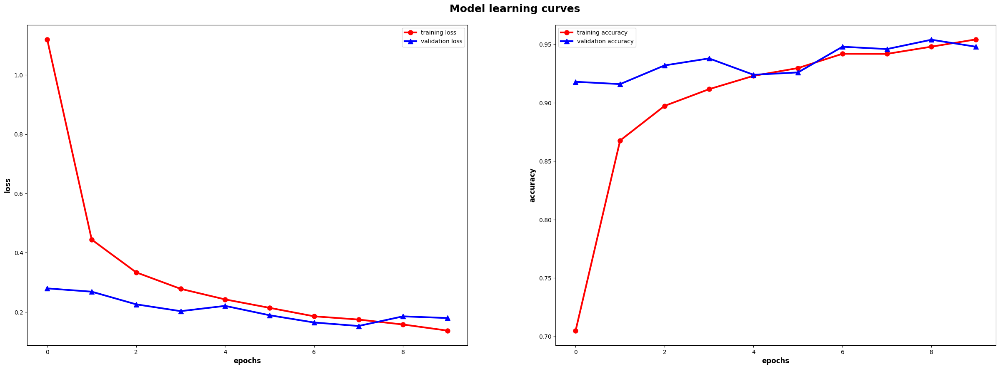

In [16]:
plot_history(history_1)

**Evaluating our model's performance on the test set**

In [17]:
scores = model.evaluate(test_data, verbose=False)

In [18]:
print(f"Root mean squared error: {scores[0]:.4f}")
print(f"Test accuracy: {scores[1]:.2%}")

Root mean squared error: 0.1856
Test accuracy: 95.20%


We have been able to achieve an accuracy of `95.2%` by using the ResNet-50 model and settings it trainable parameter to False. 

Can we do better ?

In [19]:
# making predictions

pred_1 = model.predict(test_data, verbose=False)
pred_1_cleaned = np.argmax(pred_1, axis=1)

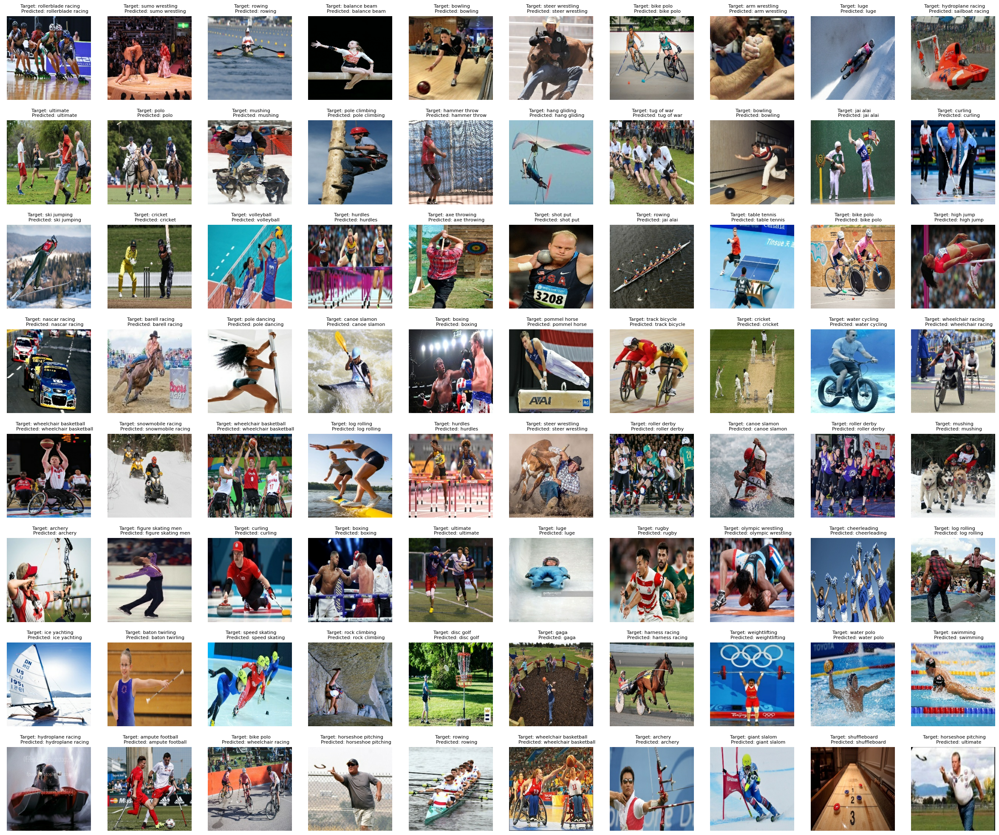

In [20]:
# visualizing our predictions

plt.figure(figsize=(30,25))
range_ = 0
for images, labels in test_data.take(5):
    range_ += len(labels)
    prev = range_ - len(labels)
    for i in range(prev, range_):
        plt.subplot(8, 10, i+1)
        x = images[i - prev].numpy() / 255.
        
        plt.title(f"""  Target: {class_names[labels[i - prev].numpy()]}
        Predicted: {class_names[pred_1_cleaned[i]]}""", fontsize=8)
        plt.imshow(x)
        plt.axis('off')
   

Going by our predictions, it seems our model has indeed performed well

**Confusion Matrix & Classification Report**

In [21]:
# Retrieving our labels

test_labels = []
for images, labels in test_data.take(-1):
    for i in range(len(labels)):
        test_labels.append(labels[i].numpy())

In [22]:
print(classification_report(pred_1_cleaned, test_labels))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         5
           1       1.00      1.00      1.00         5
           2       1.00      0.83      0.91         6
           3       1.00      1.00      1.00         5
           4       1.00      1.00      1.00         5
           5       1.00      1.00      1.00         5
           6       1.00      1.00      1.00         5
           7       0.40      1.00      0.57         2
           8       1.00      1.00      1.00         5
           9       0.80      0.80      0.80         5
          10       0.80      0.80      0.80         5
          11       1.00      1.00      1.00         5
          12       0.60      1.00      0.75         3
          13       0.80      1.00      0.89         4
          14       1.00      1.00      1.00         5
          15       1.00      1.00      1.00         5
          16       1.00      1.00      1.00         5
          17       1.00    

Decent precision, recall & f1 score

In [23]:
# confusion matrix

conf_matrix_1 = confusion_matrix(test_labels, pred_1_cleaned)
np.fill_diagonal(conf_matrix_1, 0)

In [24]:
labels = [class_names[val] for val in np.unique(test_labels)]

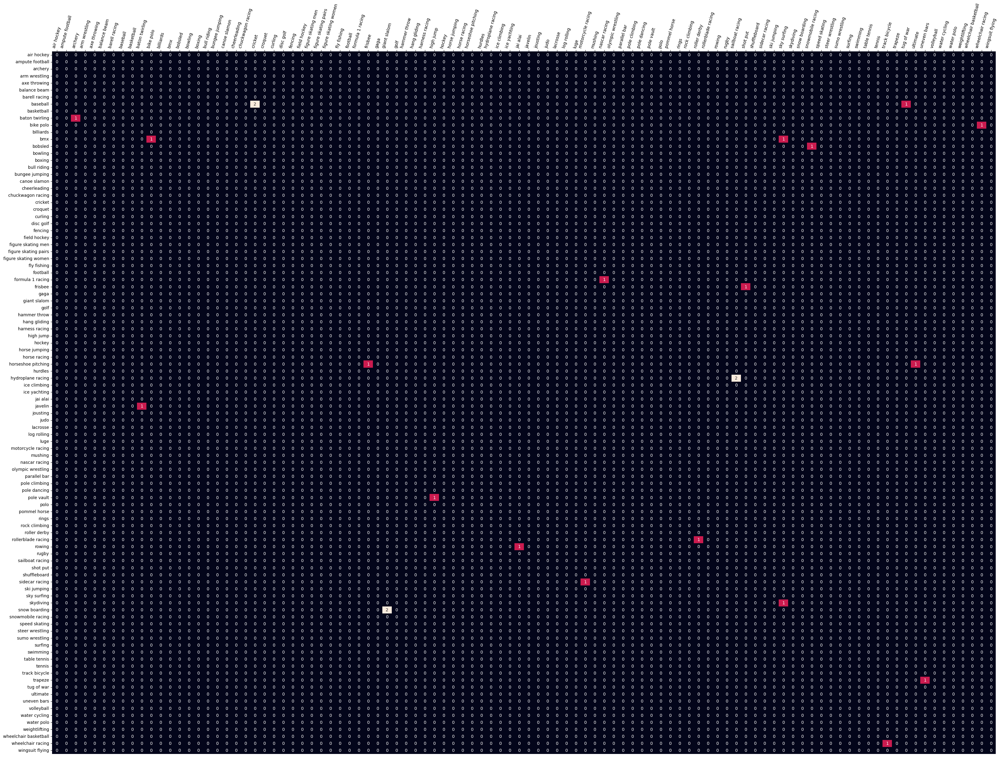

In [25]:
plt.figure(figsize=(40, 30))
g = sns.heatmap(conf_matrix_1, cbar=False, annot=True)
g.set_xticklabels(labels=labels, rotation=75)
g.xaxis.tick_top()
g.set_yticklabels(labels=labels, rotation=0)
plt.show()

Our model performed well overall. However, we had 24 wrong predictions!

**Visualizing wrong predictions**

In [26]:
# Retrieving our test images

test_images = []
for images, labels in test_data.take(-1):
    for i in range(len(labels)):
        test_images.append(images[i].numpy())
        
test_images = np.array(test_images)

In [27]:
# indexes for wrong predicitions

idx = test_labels != pred_1_cleaned
idx = idx.tolist()

In [28]:
X_wrong = test_images[idx]
y_wrong = pred_1_cleaned[idx]
y_correct = np.array(test_labels)[idx]

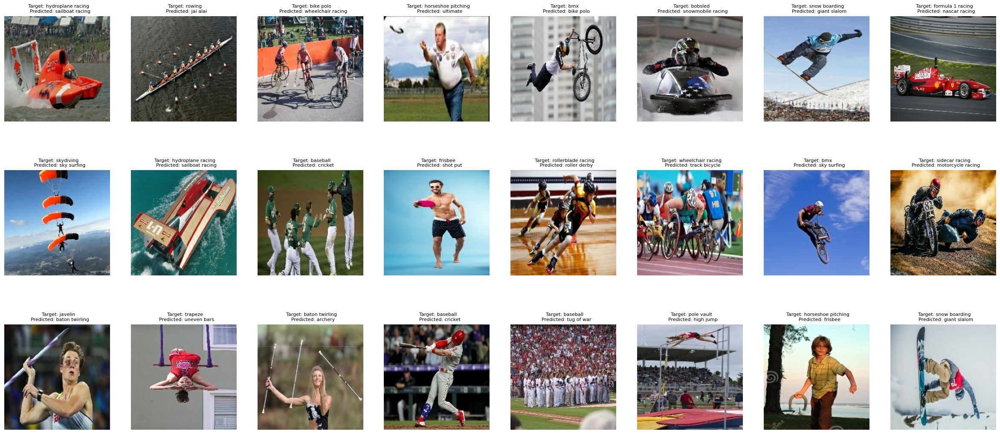

In [29]:
# visualizing wrong predictions

plt.figure(figsize=(30,18))
for i in range(len(y_wrong)):
    plt.subplot(4, 8, i+1)
    x = X_wrong[i]/255.
    
    plt.title(f"""  Target: {class_names[y_correct[i]]}
    Predicted: {class_names[y_wrong[i]]}""", fontsize=8)
    plt.imshow(x)
    plt.axis('off')
   

by visualizing the wrong predictions, we can see why the model found it difficult to accurately classify these images.

<br/>

**Fine-tuning or model**

We initially trained our model by setting our ResNet-50 trainable paramter to `False`. Now, we are going to retrain our model by setting its trainable parameter to `True` to see if we will get a performance boost.

Before we do that we will save our first model, reload and clone it, and then proceed with its retraining.

In [30]:
# saving the keras model

model.save("sports_classification_model.h5")

In [31]:
# reloading our model into another variable

cloned_model = keras.models.load_model("sports_classification_model.h5")

In [32]:
cloned_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 tf.cast (TFOpLambda)        (None, None, None, 3)     0         
                                                                 
 tf.__operators__.getitem (S  (None, None, None, 3)    0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, None, None, 3)    0         
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                      

In [33]:
# depth of our ResNet pretrained model

len(cloned_model.layers[4].layers)

175

Our ResNet model has 175 layers, rather than setting all to trainable, we will be setting only the top 65 layers to trainable.

**Why?**

It is advisable to set few top layers to tainable than the entire model because CNNs learn specialized features the higher they go. The first few layers learn very simple and generic features that generalize to almost all types of images. As you go higher up, the features are increasingly more specific to the dataset on which the model was trained. The goal of fine-tuning is to adapt these specialized features to work with the new dataset, rather than overwrite the generic learning.

In [34]:
cloned_model.layers[4].trainable = True

fine_tune_at = 110

for layer in cloned_model.layers[4].layers[:fine_tune_at]:
  layer.trainable = False

In [35]:
# setting a lower base training rate
base_learning_rate = 0.001/10

cloned_model.compile(optimizer=keras.optimizers.Adam(base_learning_rate), loss=keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

In [36]:
# we trained the initial model in 10 epochs, so we will commence from where we left off

history_2 = cloned_model.fit(train_data, validation_data=val_data, initial_epoch=9, epochs=20)

Epoch 10/20
844/844 [==============================] - 269s 311ms/step - loss: 0.5085 - accuracy: 0.8515 - val_loss: 0.3453 - val_accuracy: 0.8900
Epoch 11/20
844/844 [==============================] - 227s 269ms/step - loss: 0.2131 - accuracy: 0.9316 - val_loss: 0.2288 - val_accuracy: 0.9420
Epoch 12/20
844/844 [==============================] - 222s 263ms/step - loss: 0.1473 - accuracy: 0.9528 - val_loss: 0.2506 - val_accuracy: 0.9340
Epoch 13/20
844/844 [==============================] - 222s 263ms/step - loss: 0.1076 - accuracy: 0.9672 - val_loss: 0.2253 - val_accuracy: 0.9340
Epoch 14/20
844/844 [==============================] - 222s 263ms/step - loss: 0.0854 - accuracy: 0.9736 - val_loss: 0.2949 - val_accuracy: 0.9120
Epoch 15/20
844/844 [==============================] - 219s 259ms/step - loss: 0.0781 - accuracy: 0.9750 - val_loss: 0.2185 - val_accuracy: 0.9420
Epoch 16/20
844/844 [==============================] - 222s 264ms/step - loss: 0.0589 - accuracy: 0.9819 - val_loss: 0

In [37]:
# saving the keras model

cloned_model.save("sports_classification_cloned-model.h5")

**Visualizing our model's learning curves**

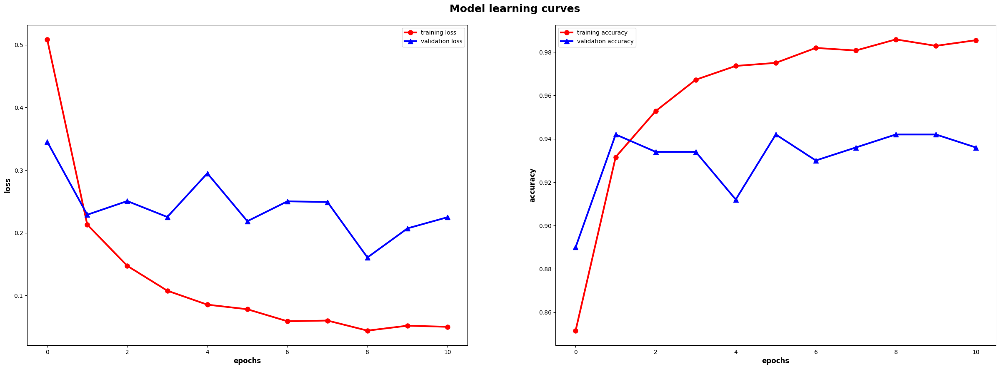

In [38]:
plot_history(history_2)

Our model seems to have began overfitting after few epochs, this could be rectified by adding a regularizer layer

**Evaluating our model's performance on the test set**

In [39]:
scores = cloned_model.evaluate(test_data, verbose=False)

In [40]:
print(f"Root mean squared error: {scores[0]:.4f}")
print(f"Test accuracy: {scores[1]:.2%}")

Root mean squared error: 0.2282
Test accuracy: 94.00%


Though our model achieved a `94.0%` accuracy on the test set, we haven't seen a significant increase by re-training our model. However in some cases, this approach increases the accuracy of the model.

In a previous runtime, i was able to achieve a higher accuracy using this procedure!

In [41]:
# making predictions

pred_2 = cloned_model.predict(test_data, verbose=False)
pred_2_cleaned = np.argmax(pred_1, axis=1)

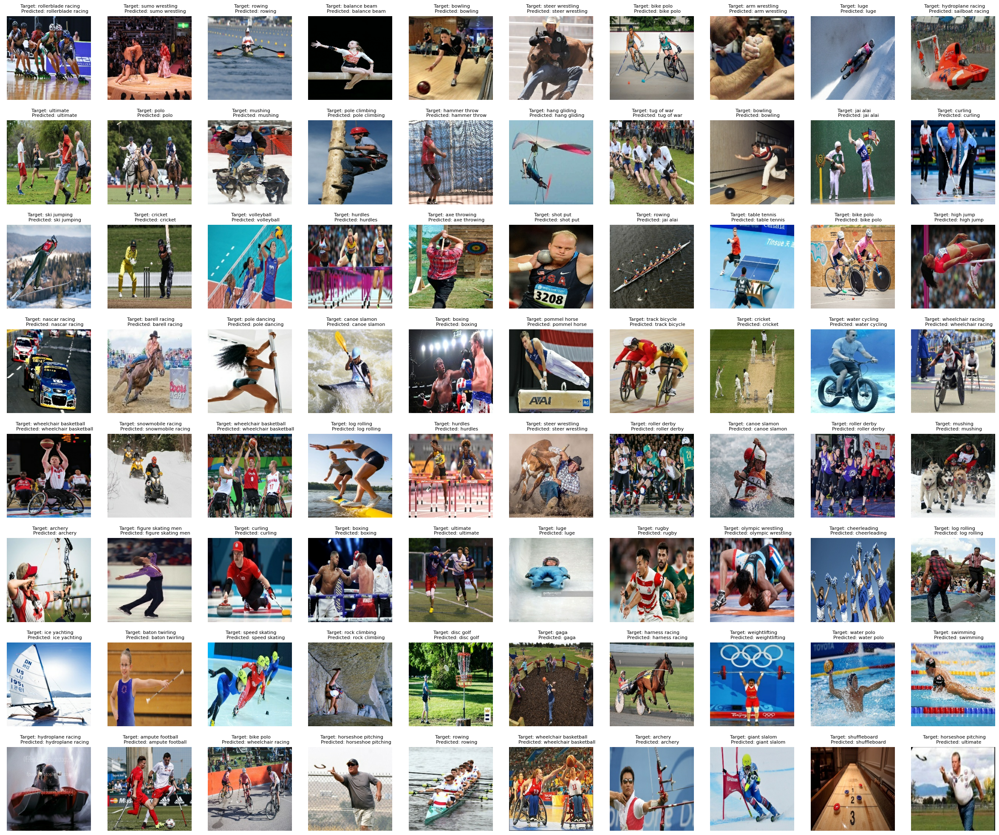

In [42]:
# visualizing our predictions

plt.figure(figsize=(30,25))
range_ = 0
for images, labels in test_data.take(5):
    range_ += len(labels)
    prev = range_ - len(labels)
    for i in range(prev, range_):
        plt.subplot(8, 10, i+1)
        x = images[i - prev].numpy() / 255.
        
        plt.title(f"""  Target: {class_names[labels[i - prev].numpy()]}
        Predicted: {class_names[pred_2_cleaned[i]]}""", fontsize=8)
        plt.imshow(x)
        plt.axis('off')
   

Going by our predictions, it seems our model has indeed performed well

**Confusion Matrix & Classification Report**

In [43]:
print(classification_report(pred_2_cleaned, test_labels))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         5
           1       1.00      1.00      1.00         5
           2       1.00      0.83      0.91         6
           3       1.00      1.00      1.00         5
           4       1.00      1.00      1.00         5
           5       1.00      1.00      1.00         5
           6       1.00      1.00      1.00         5
           7       0.40      1.00      0.57         2
           8       1.00      1.00      1.00         5
           9       0.80      0.80      0.80         5
          10       0.80      0.80      0.80         5
          11       1.00      1.00      1.00         5
          12       0.60      1.00      0.75         3
          13       0.80      1.00      0.89         4
          14       1.00      1.00      1.00         5
          15       1.00      1.00      1.00         5
          16       1.00      1.00      1.00         5
          17       1.00    

Decent precision, recall & f1 score

In [44]:
# confusion matrix

conf_matrix_2 = confusion_matrix(test_labels, pred_2_cleaned)
np.fill_diagonal(conf_matrix_2, 0)

In [45]:
labels = [class_names[val] for val in np.unique(test_labels)]

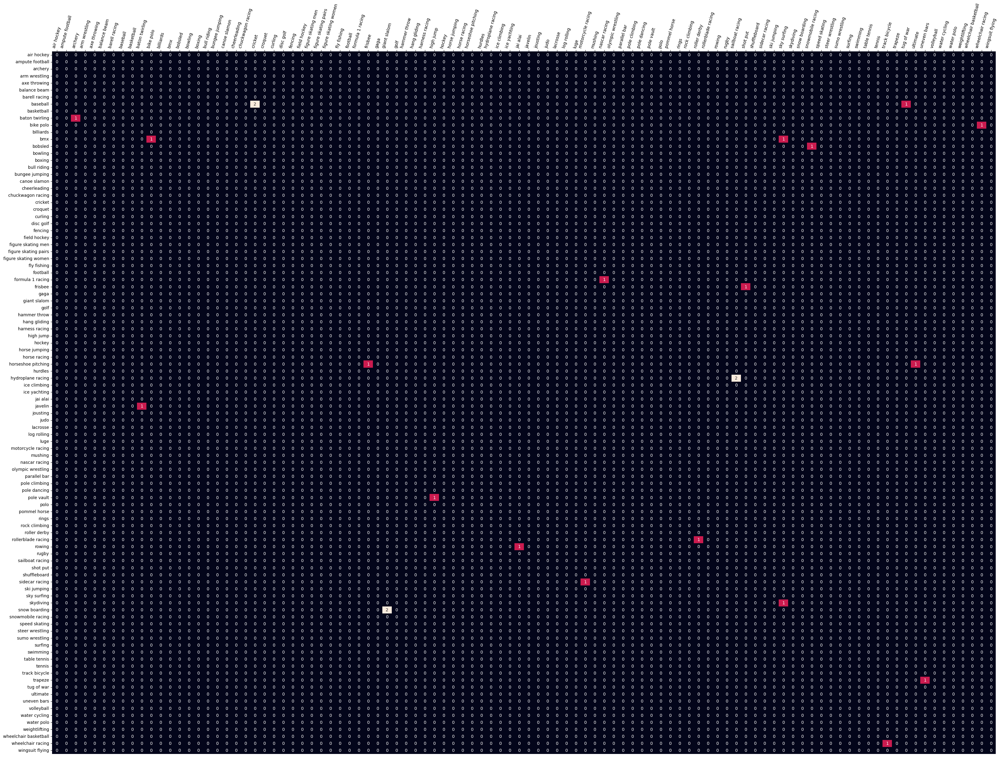

In [46]:
plt.figure(figsize=(40, 30))
g = sns.heatmap(conf_matrix_2, cbar=False, annot=True)
g.set_xticklabels(labels=labels, rotation=75)
g.xaxis.tick_top()
g.set_yticklabels(labels=labels, rotation=0)
plt.show()

**Visualizing wrong predictions**

In [47]:
# indexes for wrong predicitions

idx_2 = test_labels != pred_2_cleaned
idx_2 = idx_2.tolist()

In [48]:
X_wrong_2 = test_images[idx_2]
y_wrong_2 = pred_2_cleaned[idx_2]
y_correct_2 = np.array(test_labels)[idx_2]

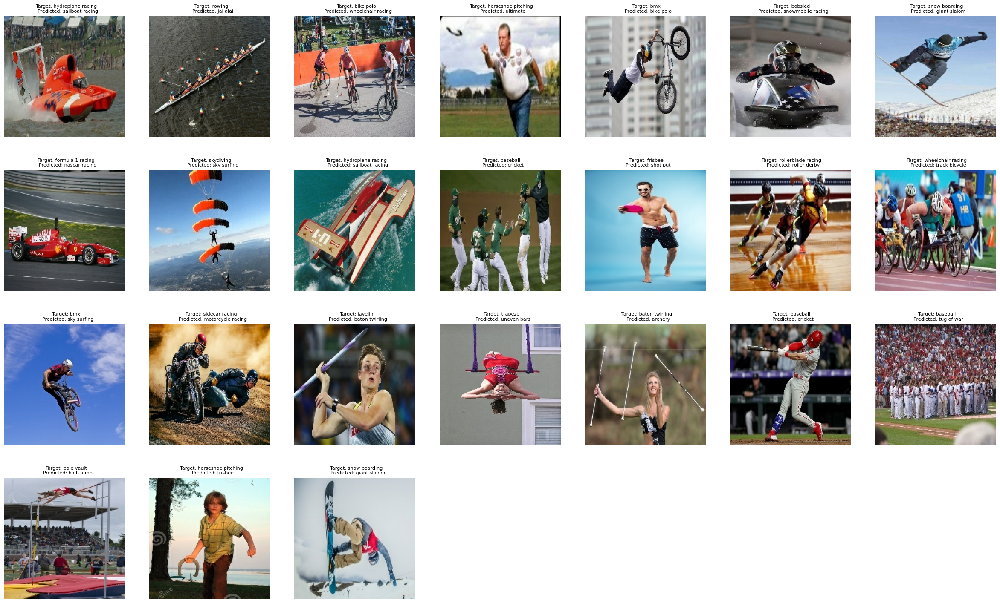

In [50]:
# visualizing wrong predictions

plt.figure(figsize=(30,18))
for i in range(24):
    plt.subplot(4, 7, i+1)
    x = X_wrong_2[i]/255.
    
    plt.title(f"""  Target: {class_names[y_correct_2[i]]}
    Predicted: {class_names[y_wrong_2[i]]}""", fontsize=8)
    plt.imshow(x)
    plt.axis('off')
   

Again, from our visualization, we can why our model classified those images incorrectly. Some of the misclassified images can be mistake for the other due to howe similar they are!